<a href="https://colab.research.google.com/github/sitthatkaja/ThesisM.Sc./blob/main/OpenFace_2_0_Landmark.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Publication

OpenFace 2.0: Facial Behavior Analysis Toolkit Tadas Baltrušaitis, Amir Zadeh, Yao Chong Lim, and Louis-Philippe Morency, IEEE International Conference on Automatic Face and Gesture Recognition, 2018

https://ieeexplore.ieee.org/stamp/stamp.jsp?tp=&arnumber=8373812

---

problems

ต้องมีไฟล์ของ dlib ก่อน

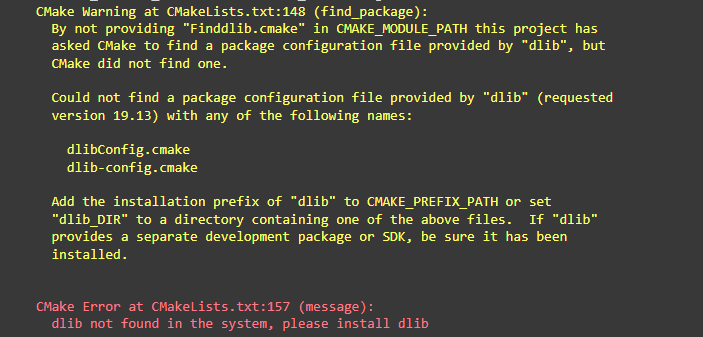

---

In [1]:
!apt-get update
!apt-get install -y build-essential cmake
!apt-get install -y libopenblas-dev liblapack-dev
!apt-get install -y libx11-dev libgtk-3-dev
!apt-get install -y python3-dev python3-pip
!pip install numpy


Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:2 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [973 kB]
Hit:7 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:9 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [1,994 kB]
Get:13 http://security.ubuntu.

ลง dlib ไว้

In [2]:
# Clone the dlib repository
!git clone https://github.com/davisking/dlib.git
%cd dlib

# Create build directory
!mkdir build
%cd build

# Configure and build dlib
!cmake ..
!cmake --build . --config Release

# Install dlib
!sudo make install
!sudo ldconfig

Cloning into 'dlib'...
remote: Enumerating objects: 51694, done.
remote: Counting objects: 100% (239/239), done.
remote: Compressing objects: 100% (188/188), done.
remote: Total 51694 (delta 91), reused 139 (delta 50), pack-reused 51455
Receiving objects: 100% (51694/51694), 48.40 MiB | 20.61 MiB/s, done.
Resolving deltas: 100% (36471/36471), done.
/content/dlib
/content/dlib/build
-- The C compiler identification is GNU 11.4.0
-- The CXX compiler identification is GNU 11.4.0
-- Detecting C compiler ABI info
-- Detecting C compiler ABI info - done
-- Check for working C compiler: /usr/bin/cc - skipped
-- Detecting C compile features
-- Detecting C compile features - done
-- Detecting CXX compiler ABI info
-- Detecting CXX compiler ABI info - done
-- Check for working CXX compiler: /usr/bin/c++ - skipped
-- Detecting CXX compile features
-- Detecting CXX compile features - done
-- Using CMake version: 3.27.9
-- Compiling dlib version: 19.24.99
-- Performing Test CMAKE_HAVE_LIBC_PTHREAD


โคลน github ลองเทสว่าสามารถใช้ได้แล้วหรือยัง

In [3]:
# Clone OpenFace repository
%cd /content
!git clone https://github.com/TadasBaltrusaitis/OpenFace.git
%cd OpenFace

# Download the models required for OpenFace
!wget https://www.cl.cam.ac.uk/research/rainbow/projects/openface/models.zip
!unzip models.zip -d ./models

# Build OpenFace
!bash ./download_models.sh
!mkdir build
%cd build

# Configure and build OpenFace, specifying the dlib directory
!cmake -Ddlib_DIR=/usr/local/lib/python3.7/dist-packages/dlib ..
!make


/content
Cloning into 'OpenFace'...
remote: Enumerating objects: 21343, done.
remote: Counting objects: 100% (21343/21343), done.
remote: Compressing objects: 100% (9657/9657), done.
remote: Total 21343 (delta 11569), reused 21094 (delta 11473), pack-reused 0
Receiving objects: 100% (21343/21343), 1.63 GiB | 29.69 MiB/s, done.
Resolving deltas: 100% (11569/11569), done.
Updating files: 100% (3672/3672), done.
/content/OpenFace
--2024-07-07 13:42:14--  https://www.cl.cam.ac.uk/research/rainbow/projects/openface/models.zip
Resolving www.cl.cam.ac.uk (www.cl.cam.ac.uk)... 128.232.0.20, 2a05:b400:110::80:14
Connecting to www.cl.cam.ac.uk (www.cl.cam.ac.uk)|128.232.0.20|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2024-07-07 13:42:14 ERROR 404: Not Found.

unzip:  cannot find or open models.zip, models.zip.zip or models.zip.ZIP.
--2024-07-07 13:42:15--  https://www.dropbox.com/s/7na5qsjzz8yfoer/cen_patches_0.25_of.dat
Resolving www.dropbox.com (www.dropbox.com)..

In [4]:
!mkdir -p /content/output

In [5]:
from google.colab import files
uploaded = files.upload()

# Assume the uploaded file is named 'video.mp4'
for fn in uploaded.keys():
    !./FaceLandmarkVidMulti -f "{fn}" -out_dir "/content/output/"

Saving Blink and no (2).mp4 to Blink and no (2).mp4
/bin/bash: line 1: ./FaceLandmarkVidMulti: No such file or directory


In [6]:
import os
from google.colab import files

# Download the output directory
!zip -r output.zip /content/output
files.download('output.zip')

  adding: content/output/ (stored 0%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

---

In [7]:
# Create a directory to store models
!mkdir -p /content/models/dlib

# Download the shape predictor model
!wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2 -P /content/models/dlib

# Extract the model
!bzip2 -d /content/models/dlib/shape_predictor_68_face_landmarks.dat.bz2

--2024-07-07 13:53:09--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘/content/models/dlib/shape_predictor_68_face_landmarks.dat.bz2’

shape_predictor_68_ 100%[===================>]  61.07M   160MB/s    in 0.4s    

2024-07-07 13:53:10 (160 MB/s) - ‘/content/models/dlib/shape_predictor_68_face_landmarks.dat.bz2’ saved [64040097/64040097]



Saving Blink and no (2).mp4 to Blink and no (2) (2).mp4


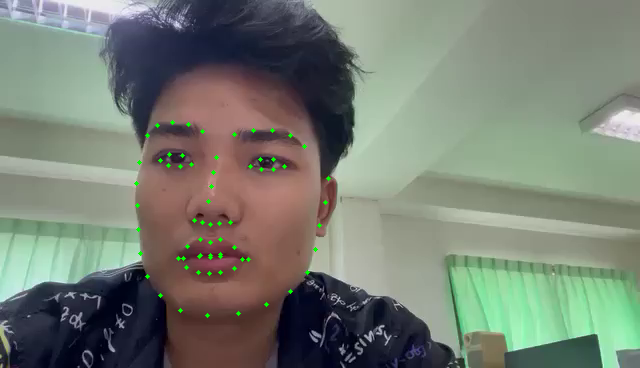

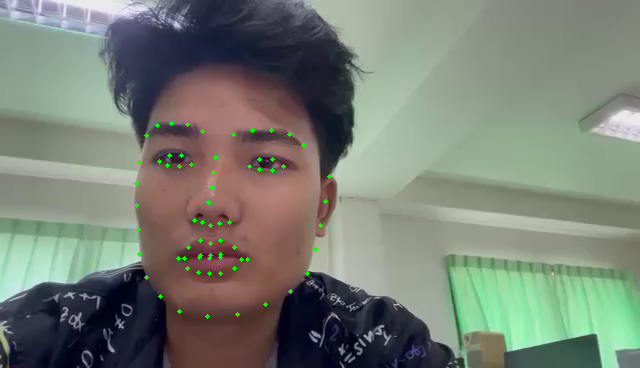

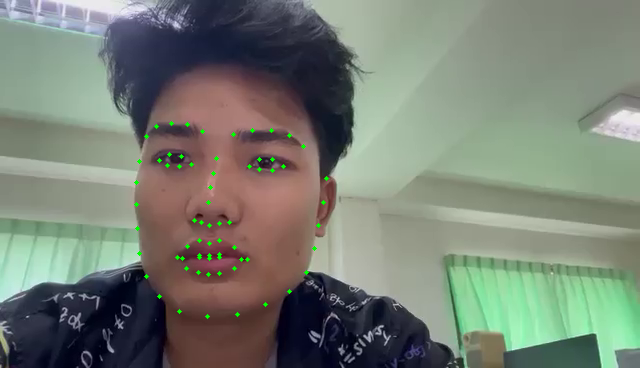

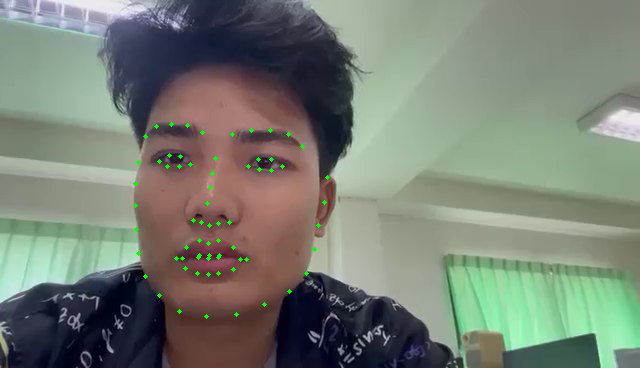

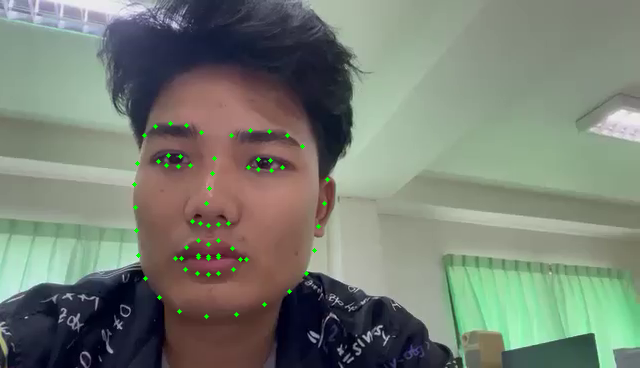

...

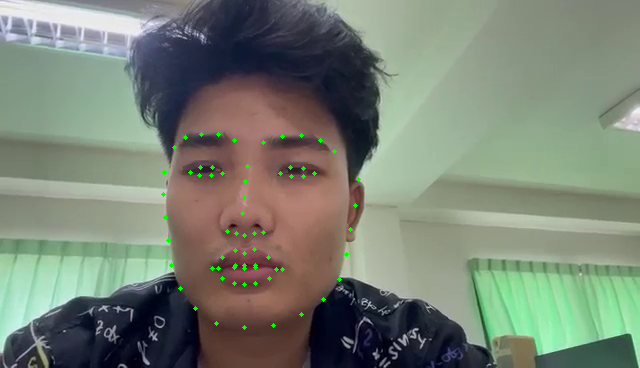

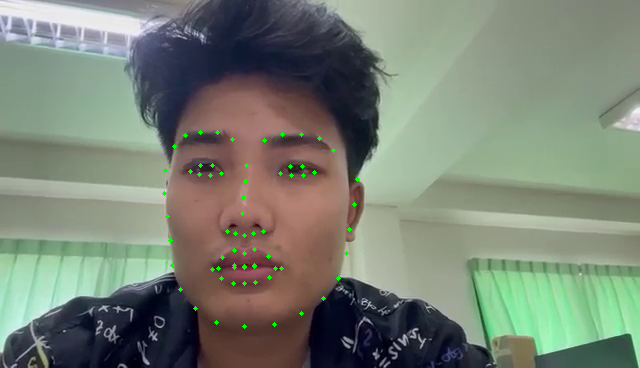

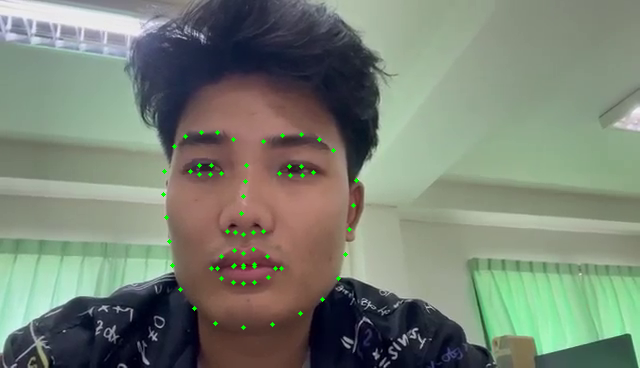

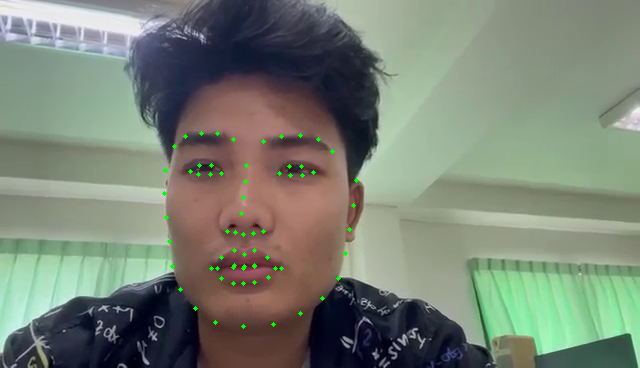

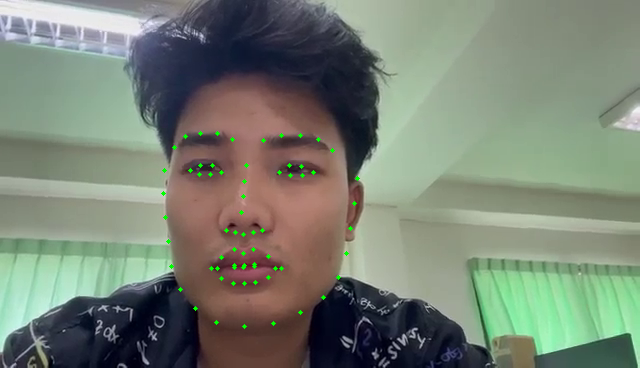

In [9]:
import cv2
import dlib
import numpy as np
from google.colab.patches import cv2_imshow

# Load the OpenFace model
face_detector = dlib.get_frontal_face_detector()
landmark_predictor = dlib.shape_predictor('/content/models/dlib/shape_predictor_68_face_landmarks.dat')

def get_landmarks(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Detect faces in the image
    faces = face_detector(gray)

    # If no faces are detected, return an empty list
    if len(faces) == 0:
        return []

    # Get the landmarks for the first detected face
    landmarks = landmark_predictor(gray, faces[0])

    # Convert landmarks to numpy array
    landmarks = np.array([(p.x, p.y) for p in landmarks.parts()])

    return landmarks

# Define a function to process video frames
def process_video(video_path):
    cap = cv2.VideoCapture(video_path)
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Get the landmarks
        landmarks = get_landmarks(frame)

        # Draw landmarks on the frame
        if len(landmarks) > 0:
            for (x, y) in landmarks:
                cv2.circle(frame, (x, y), 2, (0, 255, 0), -1)

        # Display the frame
        cv2_imshow(frame)

        # Press Q on keyboard to exit
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

# Upload and process video file
from google.colab import files
uploaded = files.upload()

for fn in uploaded.keys():
    process_video(fn)